## Visualising the second qubit

In [27]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import hamiltonians as hamiltonians
from pauli_matrices import *
import quantum_tools as qt

In [28]:
# Create a quantum system with a single qubit
natural_freq = 10 * 10**9
driving_freq = 10 * 10**9
rabi_freq = 5 * 10**6



# CCD parameters
phi_0, epsilon_m, phase_freq, theta_m = 0, rabi_freq/4, rabi_freq, 0



# Integration parameters
tol = 10**-6
evaluation_points = 1000
evaluation_time = 10*10**-6

initial_state = 1/np.sqrt(2) * np.array([1 + 0j, 1 + 0j])

In [19]:
t, Us = qt.calculate_unitaries(1, evaluation_time, evaluation_points, hamiltonians.ccd_rwa,
                        driving_freq=driving_freq,
                        natural_freq =  natural_freq+15*10**6, rabi_freq=rabi_freq, phi_0=phi_0,
                        epsilon_m=epsilon_m,
                        phase_freq=phase_freq,
                        theta_m=theta_m)
fid_1 = qt.calculate_fidelities(np.eye(2), Us, 2)

In [22]:
initial_state = 1/np.sqrt(2) * np.array([1 + 0j, 1 + 0j])
states = np.matmul(Us, initial_state)  # or equivalently Us @ psi_0

In [23]:
qt.visualise_solution(t, states)

Animation size has reached 21060120 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Cant remember if this is what it was supposed to look like so will check with a rabichevron plot

In [17]:
detunings = np.linspace(-20*10**6, 20*10**6, 1000)

z_expectations = []
for detuning in detunings:
    t, y = qt.evolve_state(initial_state, evaluation_time, evaluation_points, hamiltonians.ccd_rwa,
                        driving_freq=driving_freq,
                        natural_freq =  natural_freq+detuning, rabi_freq=rabi_freq, phi_0=phi_0,
                        epsilon_m=epsilon_m,
                        phase_freq=phase_freq,
                        theta_m=theta_m)
    z_expectations.append(qt.calculate_expectations(y, sigma_z))


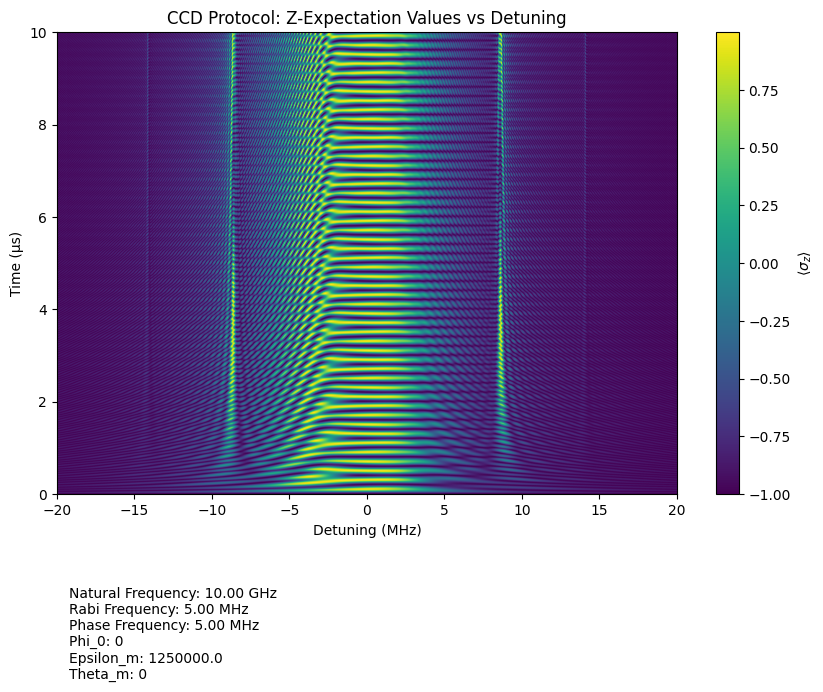

In [18]:
# Convert z_expectations list to numpy array and transpose
z_exp_array = np.array(z_expectations).T

t_micro = t * 10**6  # Convert to microseconds

# Create the color plot using the same time and detuning axes as before
plt.figure(figsize=(10, 6))
plt.imshow(z_exp_array, aspect='auto', 
                 extent=[(detunings[0])/1e6, 
                              (detunings[-1])/1e6, 
                              t_micro[0], t_micro[-1]], 
                 origin='lower', cmap='viridis')

plt.colorbar(label=r'$\langle\sigma_z\rangle$')
plt.xlabel('Detuning (MHz)')
plt.ylabel('Time (µs)')
plt.title('CCD Protocol: Z-Expectation Values vs Detuning')

# Add metadata
metadata = (f"Natural Frequency: {natural_freq/1e9:.2f} GHz\n"
                 f"Rabi Frequency: {rabi_freq/1e6:.2f} MHz\n"
                 f"Phase Frequency: {phase_freq/1e6:.2f} MHz\n"
                 f"Phi_0: {phi_0}\n"
                 f"Epsilon_m: {epsilon_m}\n"
                 f"Theta_m: {theta_m}")

plt.text(0.02, -0.2, metadata, transform=plt.gca().transAxes, 
               fontsize=10, verticalalignment='top')
plt.show()

this seems correct tho notably differs from previous plots by having the natural frequency change not the driving frequency

So is it valid to just run the second qubi in the ccd lab frame hamiltonian??

In [14]:
# Create a quantum system with a single qubit
natural_freq = 10 * 10**9
driving_freq = 10 * 10**9
rabi_freq = 5 * 10**6



# CCD parameters
phi_0, epsilon_m, phase_freq, theta_m = 0, rabi_freq/4, rabi_freq, 0



# Integration parameters
tol = 10**-2
evaluation_points = 100
evaluation_time = 10*10**-6

initial_state = np.array([1 + 0j, 0 + 0j])

In [ ]:
# Calculate unitaries for first qubit (CCD RWA)
t, Us_1 = qt.calculate_unitaries(1, evaluation_time, evaluation_points, hamiltonians.ccd_rwa, 
                        driving_freq=driving_freq,
                        natural_freq=natural_freq, rabi_freq=rabi_freq, phi_0=phi_0,
                        epsilon_m=epsilon_m,
                        phase_freq=phase_freq,
                        theta_m=theta_m)

# Calculate detuning range
detunings = np.linspace(14*10**6, 15*10**6, 2)

fidelities = []
for i, detuning in enumerate(detunings):
    # Print simple status bar
    print(f"Progress: {i+1}/{len(detunings)} detunings", end='\r')
    
    # Calculate unitaries for second qubit (lab frame CCD)
    t, Us_2 = qt.calculate_unitaries(1, evaluation_time, evaluation_points, hamiltonians.ccd_lab, rtol=tol, atol=tol,
                            driving_freq=driving_freq,
                            natural_freq=natural_freq+detuning, rabi_freq=rabi_freq, phi_0=phi_0,
                            epsilon_m=epsilon_m,
                            phase_freq=phase_freq,
                            theta_m=theta_m)
    
    # Tensor product of unitaries
    Us_combined = np.array([np.kron(U1, U2) for U1, U2 in zip(Us_1, Us_2)])
    
    # find the fidelity for the comined unitaries

    fid = qt.calculate_fidelities(np.eye(4), Us_combined, 4)
    # then add fid to fidelities list
    fidelities.append(fid)
print("\nDone!")  # Print newline at end

/Users/archie/Documents/Year4/Project/Code/Functions/quantum_tools.py:26: RuntimeWarning: overflow encountered in square
  fidelities = (np.abs(trace_terms)**2 + d) / (d * (d + 1))


Progress: 2/2 detunings
Done!


/Library/Frameworks/Python.framework/Versions/3.13/lib/python3.13/site-packages/matplotlib/image.py:463: RuntimeWarning: overflow encountered in scalar multiply
  newmin = vmid - dv * fact
/Library/Frameworks/Python.framework/Versions/3.13/lib/python3.13/site-packages/matplotlib/image.py:468: RuntimeWarning: overflow encountered in scalar multiply
  newmax = vmid + dv * fact


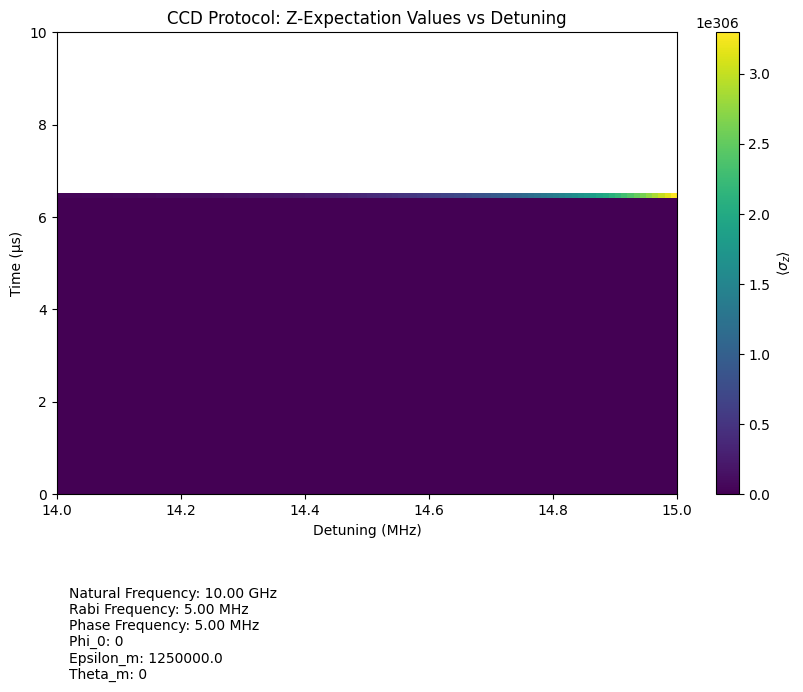

In [26]:
# Convert z_expectations list to numpy array and transpose
z_exp_array = np.array(z_expectations).T

t_micro = t * 10**6  # Convert to microseconds

# Create the color plot using the same time and detuning axes as before
plt.figure(figsize=(10, 6))
plt.imshow(z_exp_array, aspect='auto', 
           extent=[(detunings[0])/1e6, 
                   (detunings[-1])/1e6, 
                   t_micro[0], t_micro[-1]], 
           origin='lower', cmap='viridis')

plt.colorbar(label=r'$\langle\sigma_z\rangle$')
plt.xlabel('Detuning (MHz)')
plt.ylabel('Time (µs)')
plt.title('CCD Protocol: Z-Expectation Values vs Detuning')

# Add metadata
metadata = (f"Natural Frequency: {natural_freq/1e9:.2f} GHz\n"
           f"Rabi Frequency: {rabi_freq/1e6:.2f} MHz\n"
           f"Phase Frequency: {phase_freq/1e6:.2f} MHz\n"
           f"Phi_0: {phi_0}\n"
           f"Epsilon_m: {epsilon_m}\n"
           f"Theta_m: {theta_m}")

plt.text(0.02, -0.2, metadata, transform=plt.gca().transAxes, 
         fontsize=10, verticalalignment='top')
plt.show()

HMMMM

### Testing RWA then converting back to lab frame

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import hamiltonians as hamiltonians
from pauli_matrices import *
import quantum_tools as qt

In [33]:
# Create a quantum system with a single qubit
natural_freq = 10 * 10**9
driving_freq = 10 * 10**9
rabi_freq = 5 * 10**6



# CCD parameters
phi_0, epsilon_m, phase_freq, theta_m = 0, rabi_freq/4, rabi_freq, 0



# Integration parameters
tol = 10**-12
evaluation_points = 1000
evaluation_time = 10*10**-6

initial_state = np.array([0 + 0j, 1 + 0j])

In [30]:
def ccd_derotate(U, t, driving_freq, rabi_freq, epsilon_m, phase_freq, theta_m):

    # Convert frequencies to radians
    driving_omega = 2 * np.pi * driving_freq
    rabi_omega = 2 * np.pi * rabi_freq
    phase_omega = 2 * np.pi * phase_freq
    epsilon_m = 2 * np.pi * epsilon_m
    
    # Calculate the phase terms
    omega_t = driving_omega * t
    modulation = epsilon_m * np.sin(phase_omega * t - theta_m)
    
    # Calculate the diagonal elements
    upper_diagonal = np.exp(1j * (-omega_t/2 + modulation) / rabi_omega)
    lower_diagonal = np.exp(1j * (omega_t/2 - modulation) / rabi_omega)
    
    # Create and return the 2x2 matrix

    R = np.array([[upper_diagonal, 0],
                  [0, lower_diagonal]])
    return R.conj().T @ U @ R



In [31]:
# First calculate RWA unitaries
times, Us_rwa = qt.calculate_unitaries(1, evaluation_time, evaluation_points, hamiltonians.ccd_rwa,
                        driving_freq=driving_freq,
                        natural_freq=natural_freq, rabi_freq=rabi_freq, phi_0=phi_0,
                        epsilon_m=epsilon_m,
                        phase_freq=phase_freq,
                        theta_m=theta_m,
                        rtol=tol, atol=tol)

# Apply derotation to RWA unitaries using ccd_derotate
Us_derotated = np.array([ccd_derotate(U, t, driving_freq, rabi_freq, epsilon_m, phase_freq, theta_m) 
                        for U, t in zip(Us_rwa, times)])

# Calculate states for visualization
states_rwa = np.matmul(Us_rwa, initial_state)
states_derotated = np.matmul(Us_derotated, initial_state)




In [34]:
# Calculate unitaries for lab frame
t, Us_lab = qt.calculate_unitaries(1, evaluation_time, evaluation_points, hamiltonians.ccd_lab,
                        driving_freq=driving_freq,
                        natural_freq=natural_freq, rabi_freq=rabi_freq, phi_0=phi_0,
                        epsilon_m=epsilon_m,
                        phase_freq=phase_freq,
                        theta_m=theta_m,
                        rtol=tol, atol=tol)

# Calculate states for visualization
states_lab = np.matmul(Us_lab, initial_state)



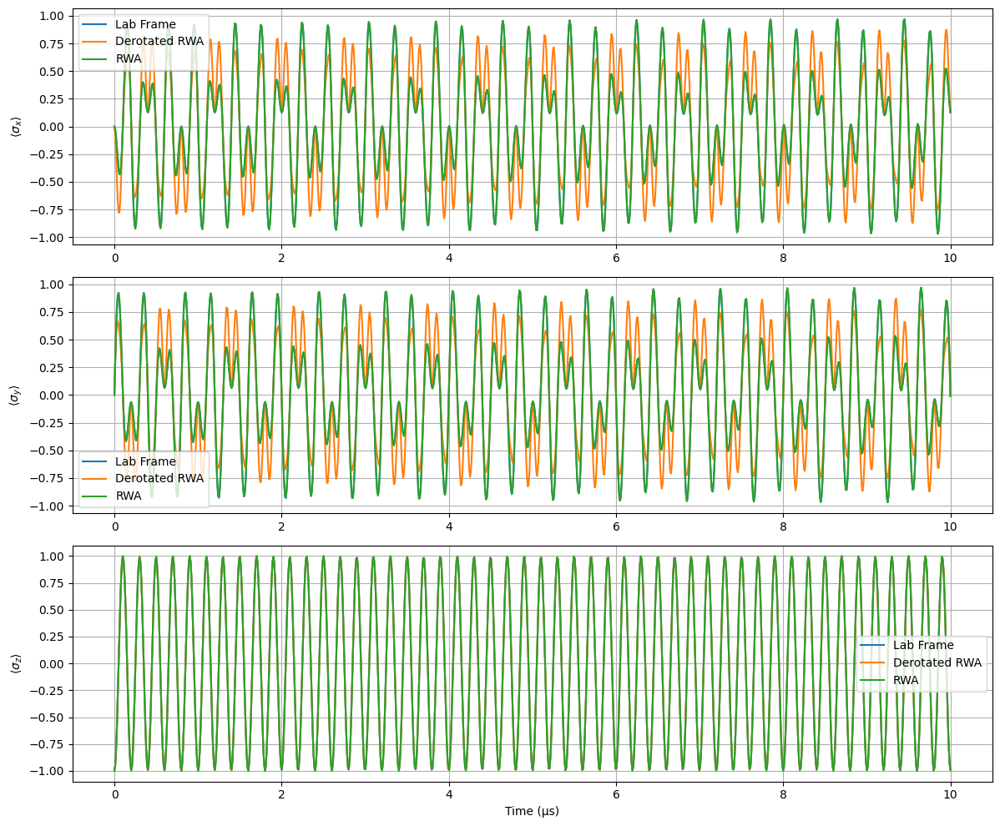

In [35]:
# Calculate expectations for all states
x_exp_lab = qt.calculate_expectations(states_lab, sigma_x)
y_exp_lab = qt.calculate_expectations(states_lab, sigma_y)
z_exp_lab = qt.calculate_expectations(states_lab, sigma_z)
x_exp_derotated = qt.calculate_expectations(states_derotated, sigma_x)
y_exp_derotated = qt.calculate_expectations(states_derotated, sigma_y)
z_exp_derotated = qt.calculate_expectations(states_derotated, sigma_z)
x_exp_rwa = qt.calculate_expectations(states_rwa, sigma_x)
y_exp_rwa = qt.calculate_expectations(states_rwa, sigma_y)
z_exp_rwa = qt.calculate_expectations(states_rwa, sigma_z)

# Create subplots for x, y, and z expectations
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(12, 10))

# Plot X expectations
ax1.plot(times * 1e6, x_exp_lab, label='Lab Frame')
ax1.plot(times * 1e6, x_exp_derotated, label='Derotated RWA')
ax1.plot(times * 1e6, x_exp_rwa, label='RWA')
ax1.set_ylabel(r'$\langle\sigma_x\rangle$')
ax1.grid(True)
ax1.legend()

# Plot Y expectations
ax2.plot(times * 1e6, y_exp_lab, label='Lab Frame')
ax2.plot(times * 1e6, y_exp_derotated, label='Derotated RWA')
ax2.plot(times * 1e6, y_exp_rwa, label='RWA')
ax2.set_ylabel(r'$\langle\sigma_y\rangle$')
ax2.grid(True)
ax2.legend()

# Plot Z expectations
ax3.plot(times * 1e6, z_exp_lab, label='Lab Frame')
ax3.plot(times * 1e6, z_exp_derotated, label='Derotated RWA')
ax3.plot(times * 1e6, z_exp_rwa, label='RWA')
ax3.set_xlabel('Time (µs)')
ax3.set_ylabel(r'$\langle\sigma_z\rangle$')
ax3.grid(True)
ax3.legend()

plt.tight_layout()
plt.show()